# DGGS GPR 2025-4 v. 2
## Tofty airborne magnetic and radiometric survey, Alaska

Source data: [https://doi.org/10.14509/31683](https://doi.org/10.14509/31683)

In [1]:
%pylab inline
import magproc.magdata
import magproc.pipeline
import magproc.plots
import os

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [2]:
d = magproc.magdata.MagData.load("../gpr2025_4v2-tofty/ascii_data/tofty_mag_final.csv", crs=32605)

/home/redhog/Projects/AGF-GeoPhysics/OM_DGGS_python_extensions/magproc/loader.py:32: DtypeWarning: Columns (33) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(f, header=None, names=column_names)


In [3]:
d

crs: 32605
filename: tofty_mag_final.csv
sample_frequency: 9.99999999996362


                     count          mean           std           min           25%           50%           75%           max
Easting   564983.0  6.012386e+05  10981.826141  5.781026e+05  5.924370e+05  6.029839e+05  6.103174e+05  6.199909e+05
Northing  564983.0  7.221421e+06   4283.112250  7.210392e+06  7.218326e+06  7.221892e+06  7.224670e+06  7.230740e+06
LONG      564983.0 -1.508444e+02      0.236218 -1.513404e+02 -1.510339e+02 -1.508071e+02 -1.506491e+02 -1.504430e+02
LAT       564983.0  6.510065e+01      0.035558  6.500781e+01  6.507536e+01  6.510422e+01  6.512741e+01  6.517890e+01
GPSALT    564983.0  3.269826e+02     80.200361  1.624200e+02  2.700700e+02  3.266500e+02  3.851600e+02  5.664800e+02
Flight    564983.0  8.972130e+01      2.704806  8.600000e+01  8.700000e+01  9.000000e+01  9.200000e+01  9.400000e+01
UTCTIME   564983.0  3.633242e+04  31154.420680  3.932800e+03  9.740300e+03  1.401350e+04  7.226

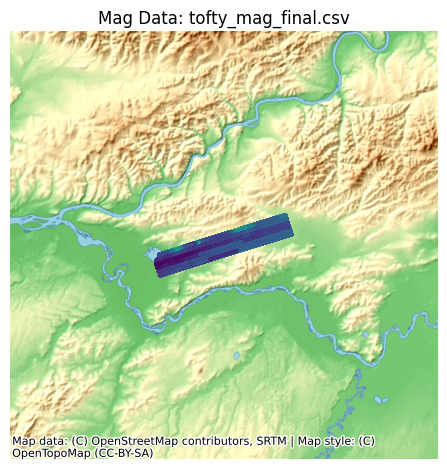

<Axes: title={'center': 'Mag Data: tofty_mag_final.csv'}>

In [4]:
d.plot_map(markersize=1, zoom=8, column="MAGCOM")

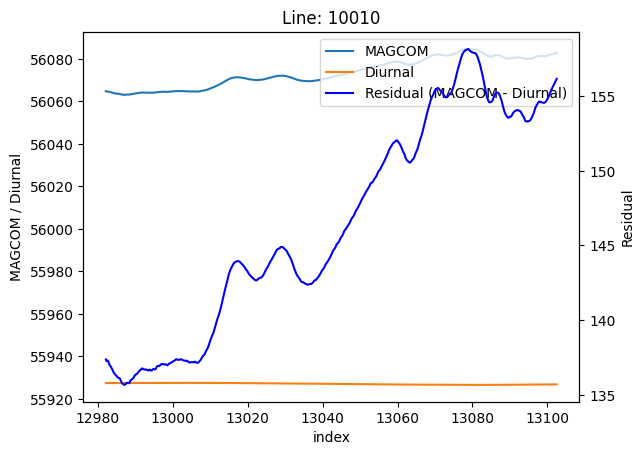

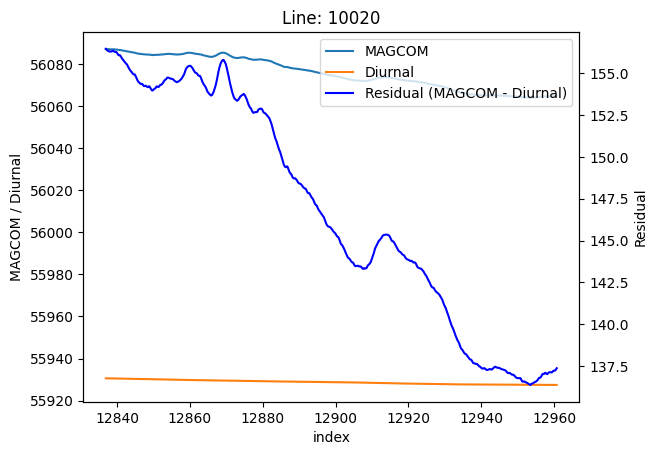

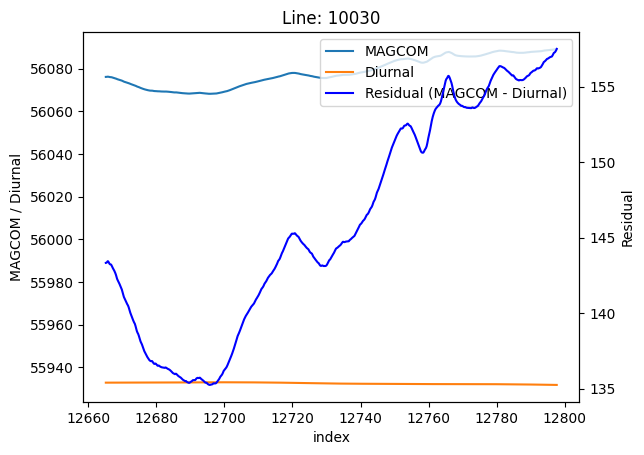

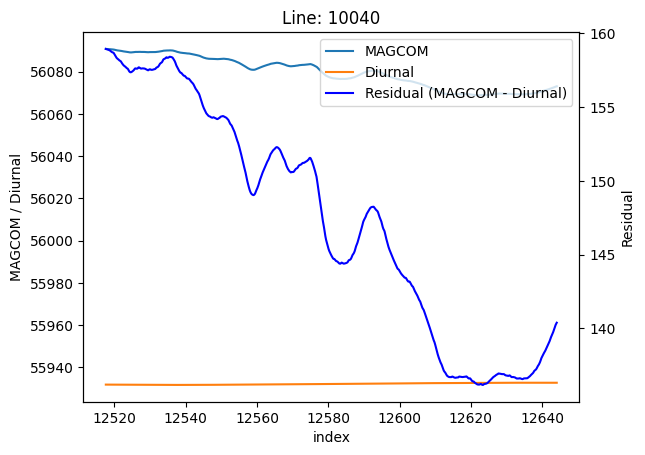

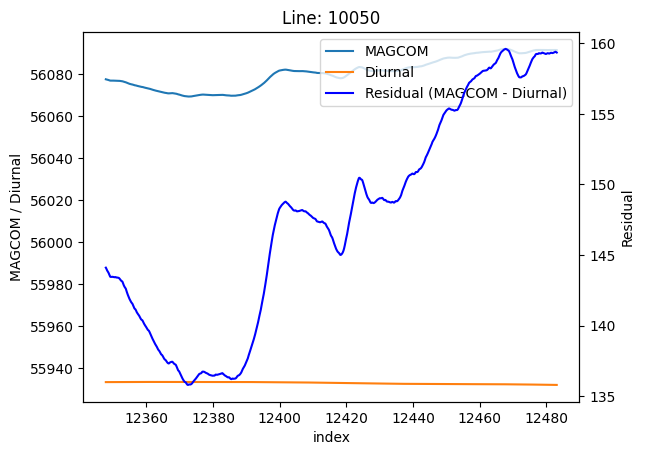

...

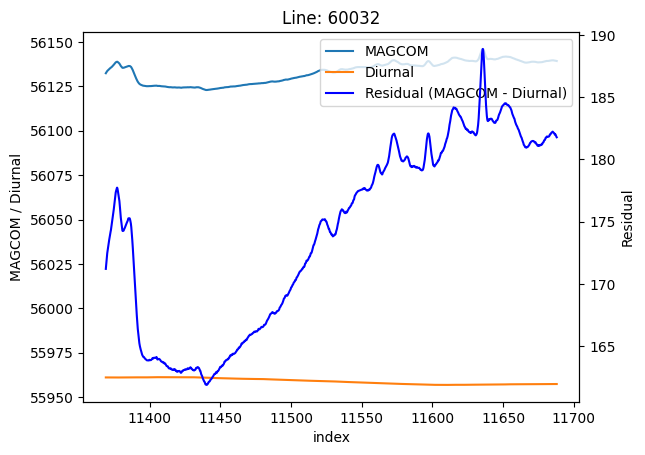

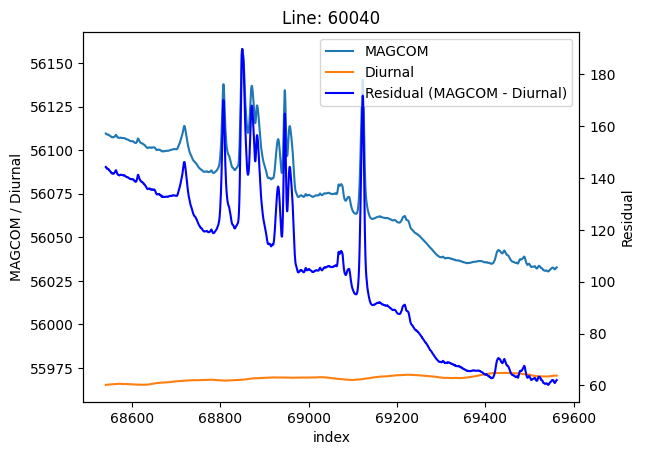

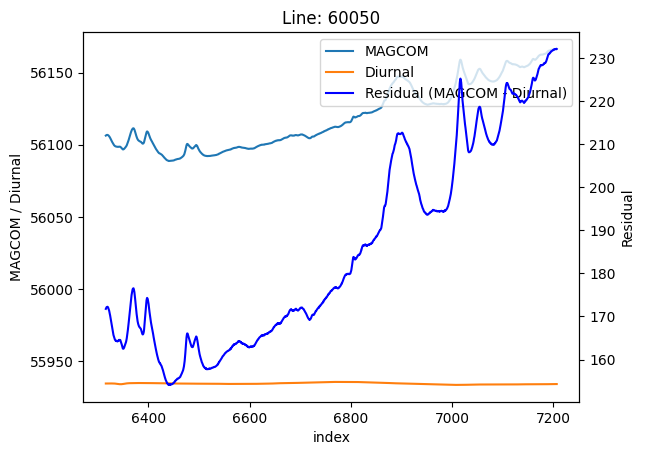

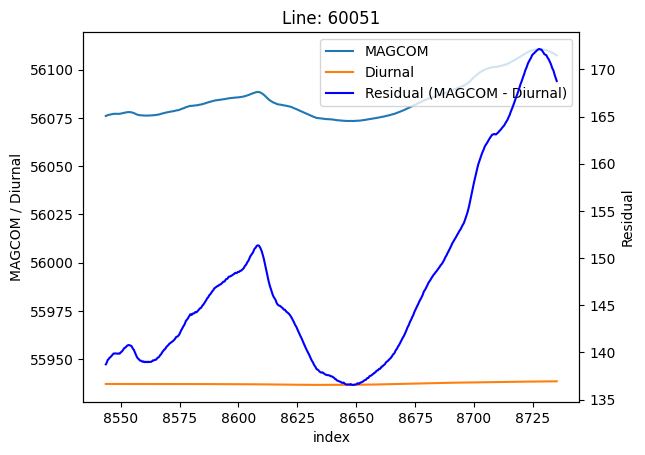

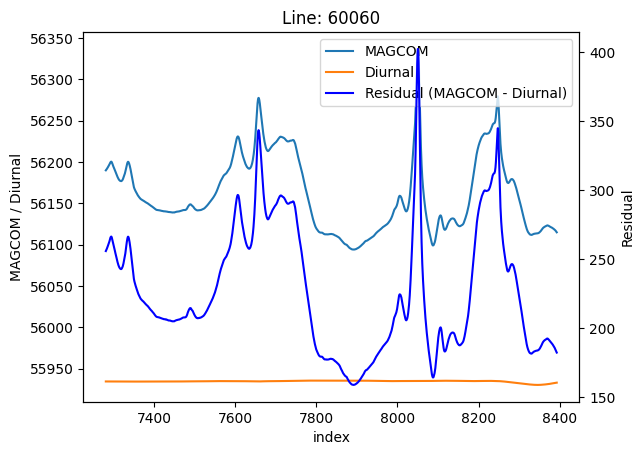

In [5]:
d.plot()

In [6]:
d.save("foo.mag.zip")

In [8]:
p = magproc.pipeline.MagPipeline.parse("""
steps:
 - surface_error
 - elevation
 - set_constants
 - downline_distance
 - lowpass_filter_butterworth:
     cutoff_freq: 0.01 # Hz, note max at the nyquist freq at sample rate 40Hz / 2
 - highpass_filter_butterworth:
     cutoff_freq: 1.0 # Hz, note max at the nyquist freq at sample rate 40Hz / 2
     column_out: hf_noise
 - diurnal_qc_for_15s_chord
 - diurnal_qc_for_60s_chord
 - drape_and_speed_qc
 - noice_qc:
     MAG_4th_diff_OOS_threshold: 0.05
 - write_noise_summary
 - write_diurnal_summary
 - write_drape_summary
""", out_path="../gpr2025_4v2-tofty.out")


In [9]:
os.makedirs(p.pipeline["out_path"], exist_ok=True)
dp = p.run(d)

Running step 0: surface_error
Running step 1: elevation
Running step 2: set_constants
Running step 3: downline_distance
Running step 4: lowpass_filter_butterworth with cutoff_freq=0.01
Running step 5: highpass_filter_butterworth with cutoff_freq=1.0, column_out=hf_noise
Running step 6: diurnal_qc_for_15s_chord
Running step 7: diurnal_qc_for_60s_chord
Running step 8: drape_and_speed_qc
Running step 9: noice_qc with MAG_4th_diff_OOS_threshold=0.05
Running step 10: write_noise_summary
Running step 11: write_diurnal_summary
Running step 12: write_drape_summary


In [11]:
dp.save("../gpr2025_4v2-tofty.out/gpr2025_4v2-tofty.mag.zip")

In [12]:
dp

crs: 32605
filename: tofty_mag_final.csv
sample_frequency: 9.99999999996362


                                     count          mean           std           min           25%           50%           75%           max
Easting                   564983.0  6.012386e+05  1.098183e+04  5.781026e+05  5.924370e+05  6.029839e+05  6.103174e+05  6.199909e+05
Northing                  564983.0  7.221421e+06  4.283112e+03  7.210392e+06  7.218326e+06  7.221892e+06  7.224670e+06  7.230740e+06
LONG                      564983.0 -1.508444e+02  2.362177e-01 -1.513404e+02 -1.510339e+02 -1.508071e+02 -1.506491e+02 -1.504430e+02
LAT                       564983.0  6.510065e+01  3.555840e-02  6.500781e+01  6.507536e+01  6.510422e+01  6.512741e+01  6.517890e+01
GPSALT                    564983.0  3.269826e+02  8.020036e+01  1.624200e+02  2.700700e+02  3.266500e+02  3.851600e+02  5.664800e+02
Flight                    564983.0  8.972130e+01  2.704806e+00  8.600000e+01  8.700000e+01  9.000000e+01  9.200000e+

In [36]:
import importlib
importlib.reload(magproc.plots)
importlib.reload(magproc.magdata)

dp = magproc.magdata.MagData(dp.data, **dp.meta)

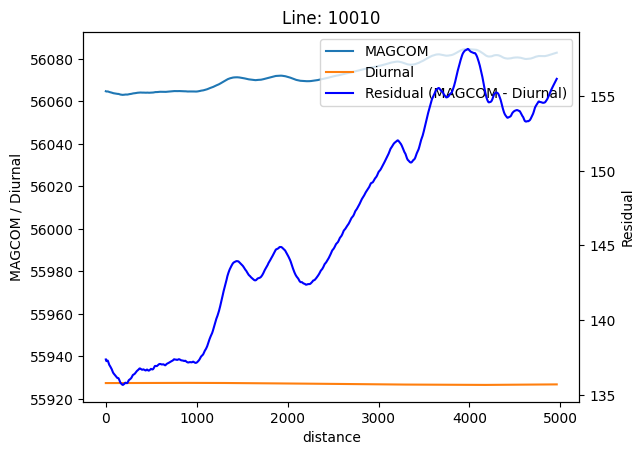

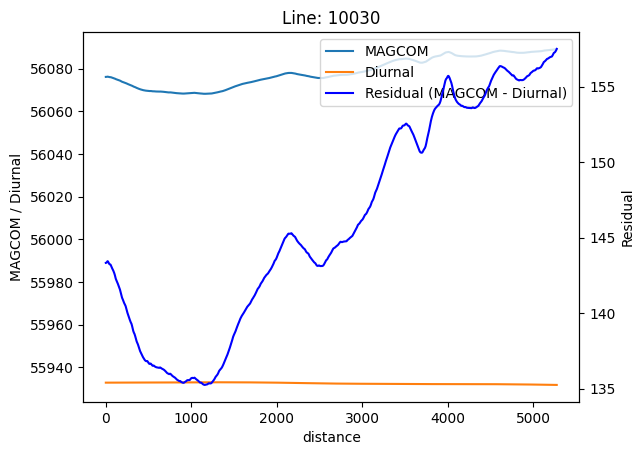

In [18]:
dp.plot_lines(
    magproc.plots.plot_line,
    lines=[10010, 10030], # Only plot these lines
    xcolumn="distance") # You can plot against any column, e.g. distance, UTCTIME, or "index" (FIDCOUNT).

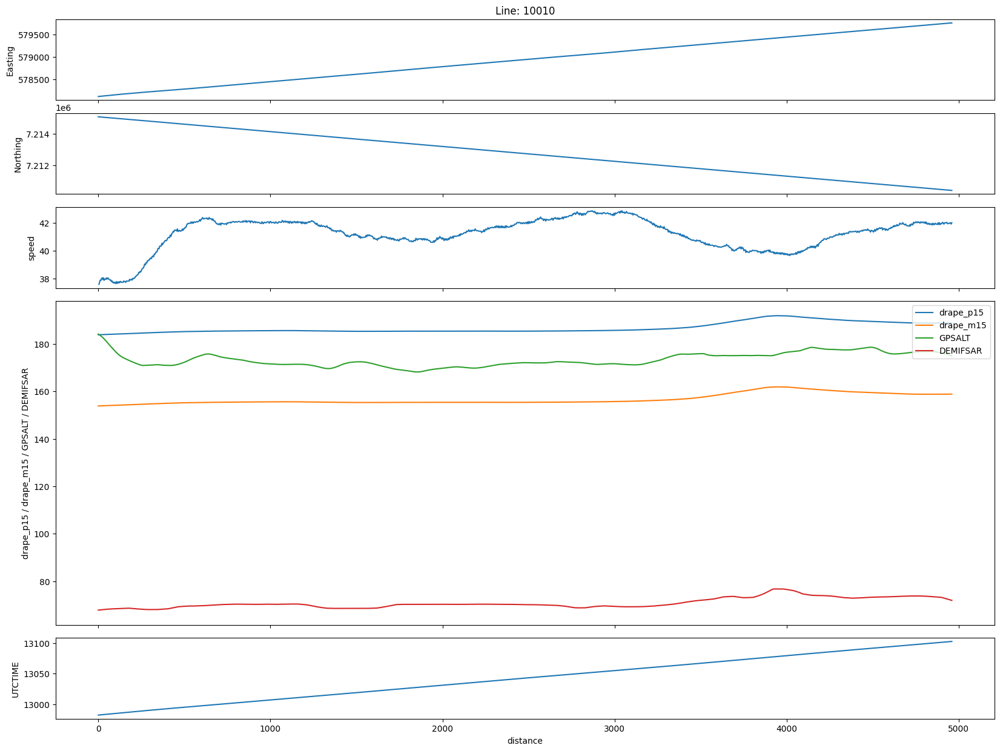

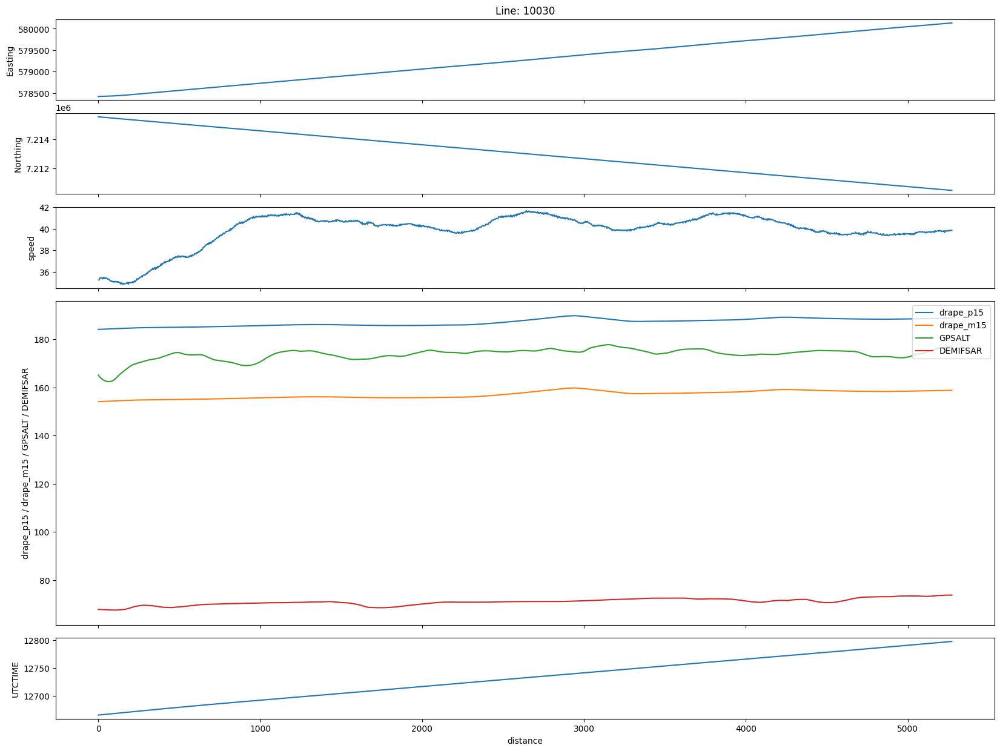

In [19]:
dp.plot_lines(
    magproc.plots.plot_drape_qc,
    lines=[10010, 10030], # Only plot these lines
    xcolumn="distance") # You can plot against any column, e.g. distance, UTCTIME, or "index" (FIDCOUNT).

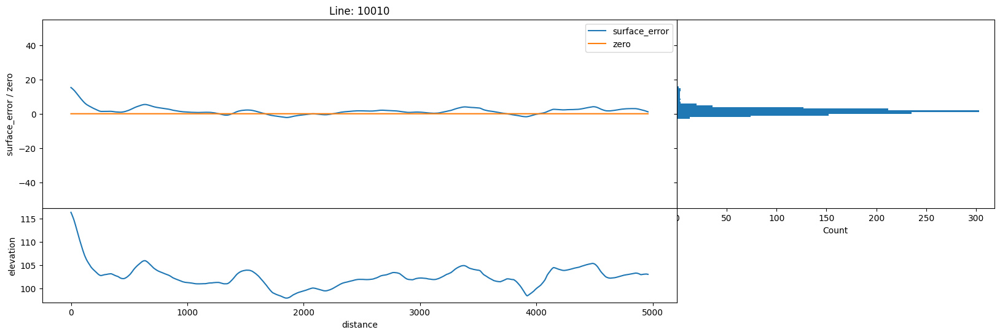

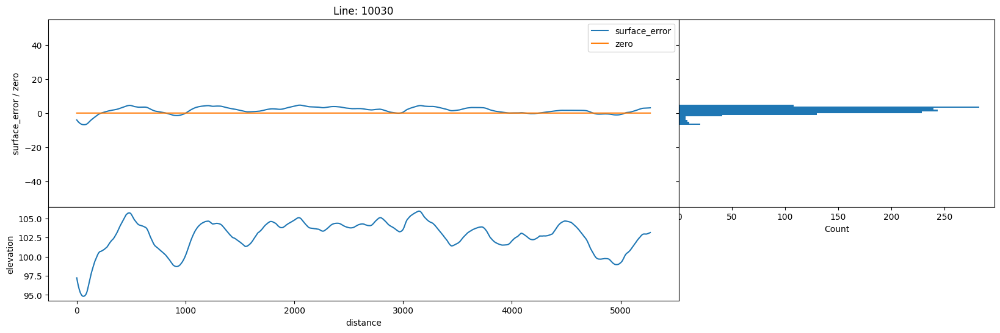

In [20]:
dp.plot_lines(
    magproc.plots.plot_drape_qc2,
    lines=[10010, 10030],
    xcolumn="distance") # You can plot against any column, e.g. distance, UTCTIME, or "index" (FIDCOUNT).

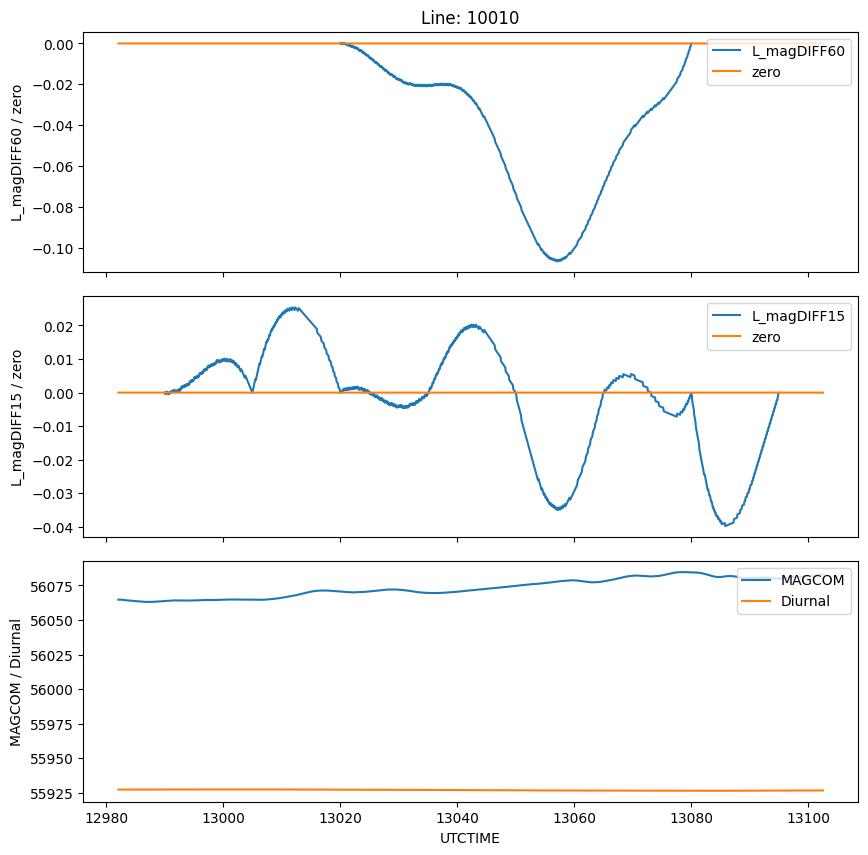

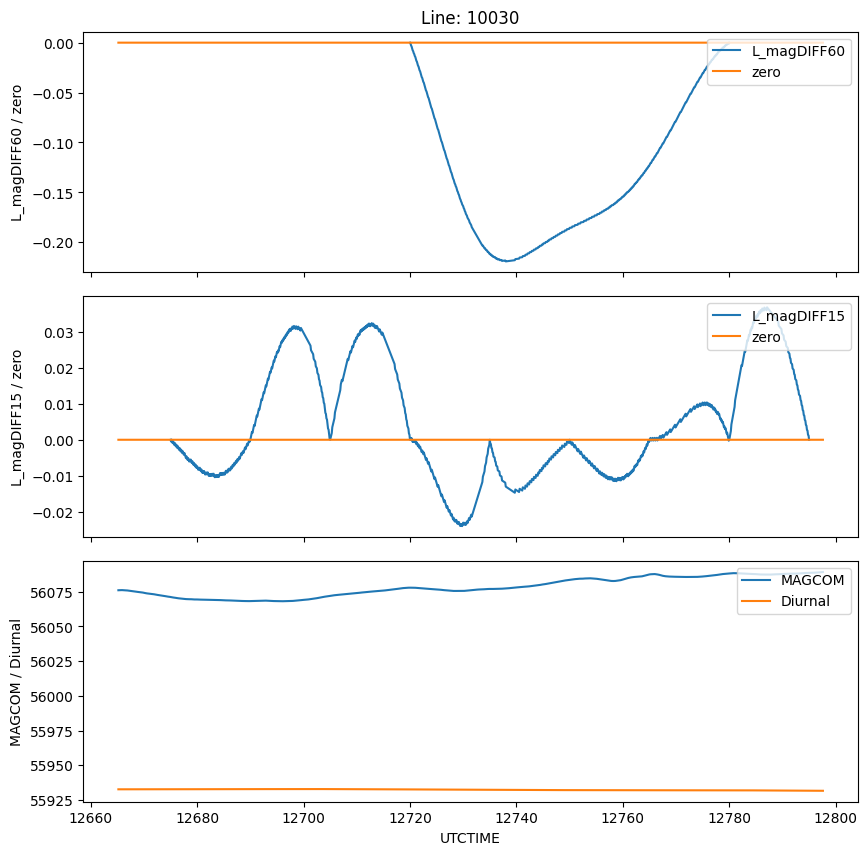

In [21]:
dp.plot_lines(
    magproc.plots.plot_diurnal_qc,
    lines=[10010, 10030],
    xcolumn="UTCTIME") # You can plot against any column, e.g. distance, UTCTIME, or "index" (FIDCOUNT).

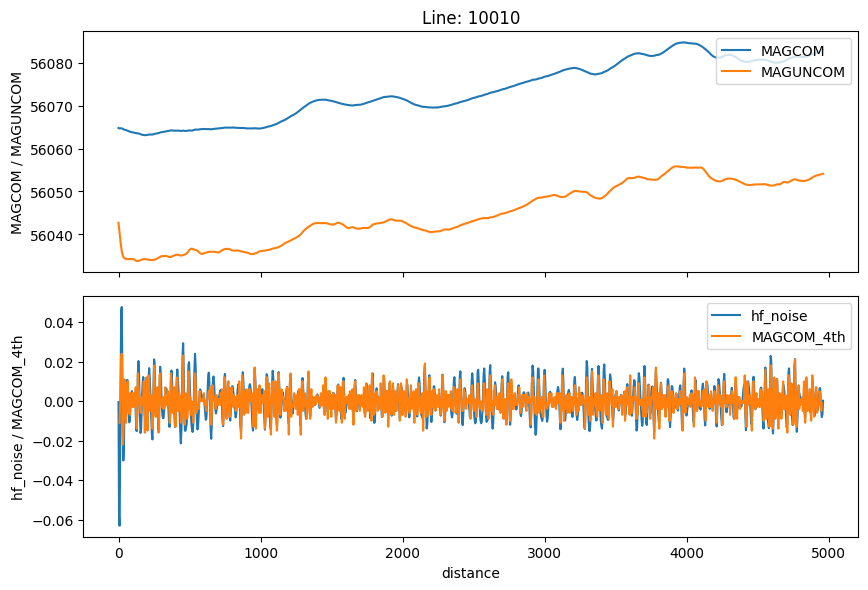

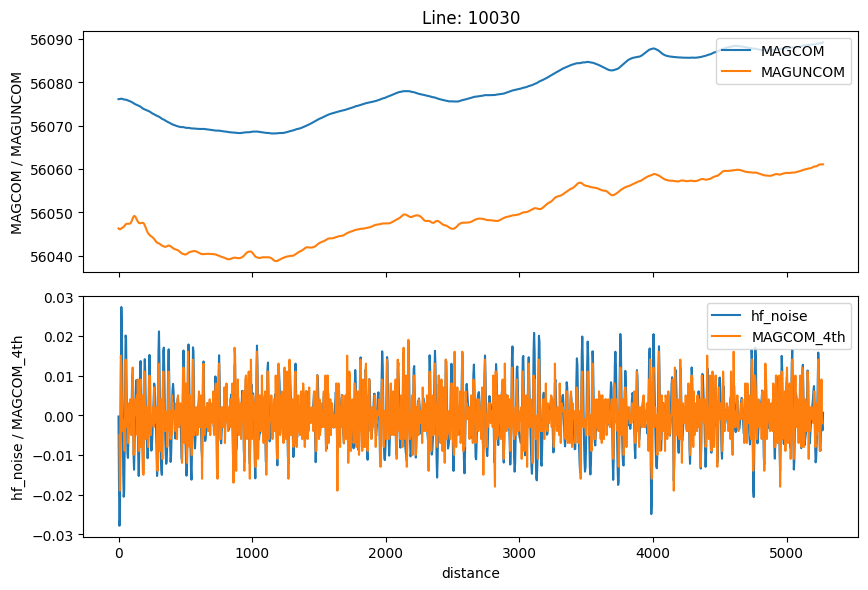

In [22]:
dp.plot_lines(
    magproc.plots.plot_hf_noise_qc,
    lines=[10010, 10030],
    xcolumn="distance") # You can plot against any column, e.g. distance, UTCTIME, or "index" (FIDCOUNT).